<h1 style="font-size:30px;">IS-Net Model Inference</h1>
<center><img src ="https://learnopencv.com/wp-content/uploads/2024/06/IS-Net-Predictions.png" width=500></center>

## Imports

In [ ]:
# Uncomment the following lines if you don't have gdown and torchinfo installed.
!pip install -qq gdown
!pip install -qq torchinfo

In [ ]:
import os
import requests
import gdown
from zipfile import ZipFile

from PIL import Image
import numpy as np

from torchinfo import summary

import torch
import torchvision.transforms as T

import torchvision.transforms.functional as F

import matplotlib.pyplot as plt

In [ ]:
DEVICE = "cuda:0" if torch.cuda.is_available() else "cpu"

## Download IS-Net Model (optimized for general use) from Gdrive

In [ ]:
ISNET_MODEL_URL = "https://drive.google.com/uc?id=1XHIzgTzY5BQHw140EDIgwIb53K659ENH"
ISNET_MODEL_PATH = "isnet-general-use.pth"

## Download Sample Images

In [ ]:
def download_and_unzip(url, save_path):

    print("Downloading and extracting assets...", end="")
    file = requests.get(url)
    # print(file.status_code)
    open(save_path, "wb").write(file.content)

    try:
        # Extract zipfile.
        if save_path.endswith(".zip"):
            with ZipFile(save_path) as zip:
                zip.extractall(os.path.split(save_path)[0])

        print("Done")
    except:
        print("Invalid file")

In [ ]:
TEST_IMAGE_DIR = "test_images"
TEST_DIR_ZIP = TEST_IMAGE_DIR+".zip"
IMAGE_DATA_URL = "https://www.dropbox.com/scl/fi/266ke2me03xgt74vdrb4x/test_images.zip?rlkey=ipul6odyiw596up1bf24dgnky&st=8a04ypoc&dl=1"

SCRIPTS_URL = "https://www.dropbox.com/scl/fo/bsqlkbvnajghhoeljf7kw/APphPibd3WjoeMHZ0IO6Q_Y?rlkey=0nqlamncqg1x0tv6hyd5unj3h&st=cq4012mz&dl=1"
SCRIPTS_ZIP = "scripts.zip"

if not os.path.exists(os.path.join(os.getcwd(), "test_images")):
    download_and_unzip(IMAGE_DATA_URL, TEST_DIR_ZIP)
    os.remove(TEST_DIR_ZIP)

if not os.path.exists(os.path.join(os.getcwd(), "u2net.py")):
    download_and_unzip(SCRIPTS_URL, SCRIPTS_ZIP)
    os.remove(SCRIPTS_ZIP)

In [ ]:
if not os.path.exists(os.path.join(os.getcwd(), ISNET_MODEL_PATH)):
    _ = gdown.download(ISNET_MODEL_URL, ISNET_MODEL_PATH)

Downloading...
From (original): https://drive.google.com/uc?id=1XHIzgTzY5BQHw140EDIgwIb53K659ENH
From (redirected): https://drive.google.com/uc?id=1XHIzgTzY5BQHw140EDIgwIb53K659ENH&confirm=t&uuid=7c32be73-d694-4552-bcd4-e4d2f8f91170
To: /content/isnet-general-use.pth
100%|██████████| 177M/177M [00:02<00:00, 81.5MB/s]


## Load Model Weights

In [ ]:
from isnet import ISNetDIS

### Model Initialization

In [ ]:
isnet = ISNetDIS(in_ch=3,out_ch=1)

### Model Summary

In [ ]:
print(f"{'IS-NET Model Summary':=^90}")
print(summary(isnet, input_size=(1,3,1024,1024), device="cpu", depth=1, row_settings=["var_names"]))

===================================IS-NET Model Summary===================================
Layer (type (var_name))                  Output Shape              Param #
ISNetDIS (ISNetDIS)                      [1, 1, 1024, 1024]        --
├─Conv2d (conv_in)                       [1, 64, 512, 512]         1,792
├─RSU7 (stage1)                          [1, 64, 512, 512]         241,152
├─MaxPool2d (pool12)                     [1, 64, 256, 256]         --
├─RSU6 (stage2)                          [1, 128, 256, 256]        305,856
├─MaxPool2d (pool23)                     [1, 128, 128, 128]        --
├─RSU5 (stage3)                          [1, 256, 128, 128]        1,108,992
├─MaxPool2d (pool34)                     [1, 256, 64, 64]          --
├─RSU4 (stage4)                          [1, 512, 64, 64]          3,986,688
├─MaxPool2d (pool45)                     [1, 512, 32, 32]          --
├─RSU4F (stage5)                         [1, 512, 32, 32]          10,034,688
├─MaxPool2d (pool56)         

### Load Pre-trained Model Weights for IS-Net

In [ ]:
def load_model(model, model_path, device):

    model.load_state_dict(torch.load(model_path, map_location=device))
    model = model.to(device)

    return model

In [ ]:
isnet = load_model(model=isnet, model_path=ISNET_MODEL_PATH, device=DEVICE)

## Data Preprocessing

In [ ]:
MEAN = torch.tensor([0.5, 0.5, 0.5])
STD = torch.tensor([1.0, 1.0, 1.0])

resize_shape = (1024,1024)

transforms = T.Compose([T.ToTensor(),
                        T.Normalize(mean=MEAN, std=STD)])

### De-Normalize Image

In [ ]:
def denorm_image(image, mean, std):
    image_denorm = torch.addcmul(mean[:,None,None], image, std[:,None, None])
    image = torch.clamp(image_denorm*255., min=0., max=255.)
    image = torch.permute(image, dims=(1,2,0)).numpy().astype("uint8")

    return image

### Prepare Image Batch

In [ ]:
def prepare_image_batch(image_dir, resize, transforms, device):

    image_batch = []

    for image_file in os.listdir(image_dir):
        image = Image.open(os.path.join(image_dir, image_file)).convert("RGB")
        image_resize = image.resize(resize, resample = Image.BILINEAR)

        image_trans = transforms(image_resize)
        image_batch.append(image_trans)


    image_batch = torch.stack(image_batch).to(device)

    return image_batch

In [ ]:
image_batch = prepare_image_batch(image_dir=TEST_IMAGE_DIR,
                                 resize=resize_shape,
                                 transforms=transforms,
                                 device=DEVICE)

## Model Predictions

In [ ]:
def prepare_predictions(model, image_batch):

    model.eval()

    all_results = []

    for image in image_batch:
        with torch.no_grad():
            results = model(image.unsqueeze(dim=0))

        all_results.append(torch.squeeze(results[0][0].cpu(), dim=(0,1)).numpy())

    return all_results

In [ ]:
predictions_isnet = prepare_predictions(isnet, image_batch)

/usr/local/lib/python3.10/dist-packages/torch/nn/modules/conv.py:456: UserWarning: Plan failed with a cudnnException: CUDNN_BACKEND_EXECUTION_PLAN_DESCRIPTOR: cudnnFinalize Descriptor Failed cudnn_status: CUDNN_STATUS_NOT_SUPPORTED (Triggered internally at ../aten/src/ATen/native/cudnn/Conv_v8.cpp:919.)
  return F.conv2d(input, weight, bias, self.stride,


## Normalize Model Predictions

In [ ]:
def normPRED(predicted_map):
    ma = np.max(predicted_map)
    mi = np.min(predicted_map)

    map_normalize = (predicted_map - mi) / (ma-mi)

    return map_normalize

## Prediction Visualizations

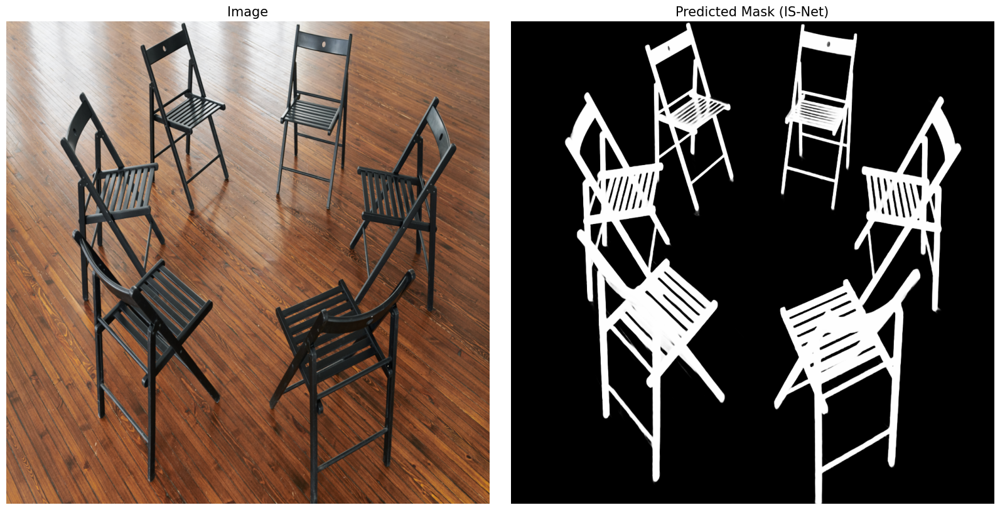

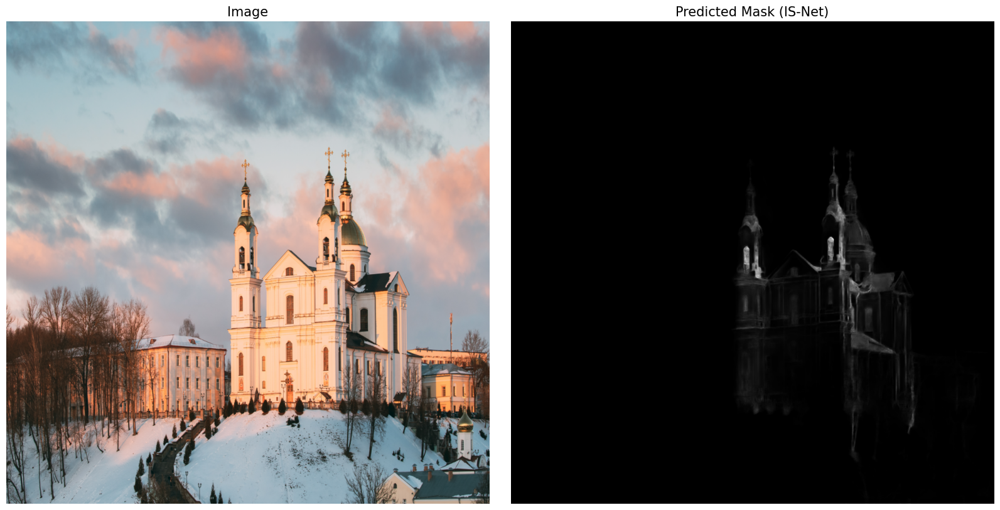

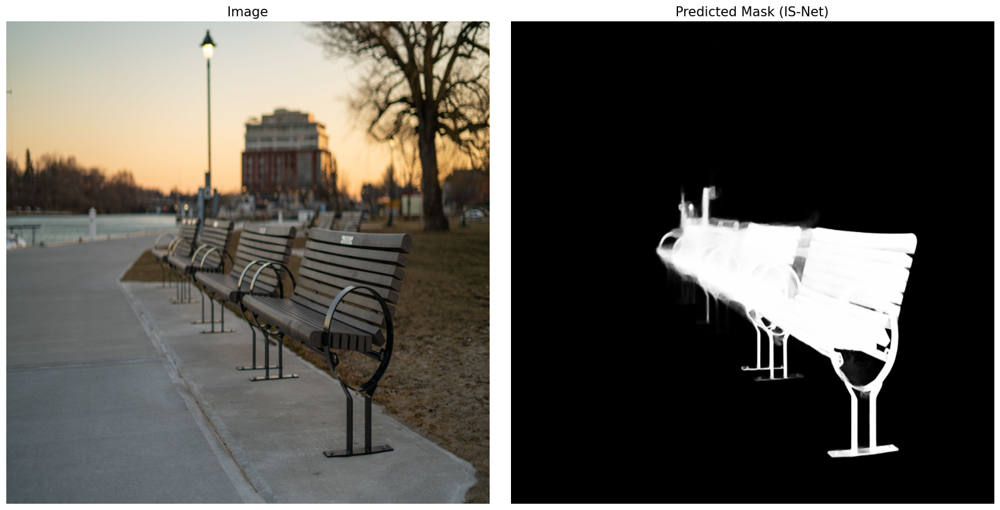

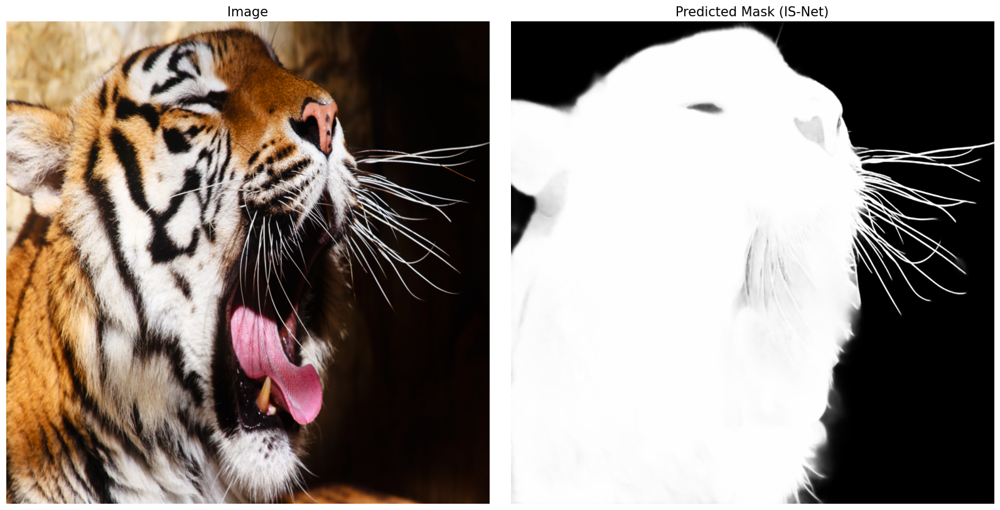

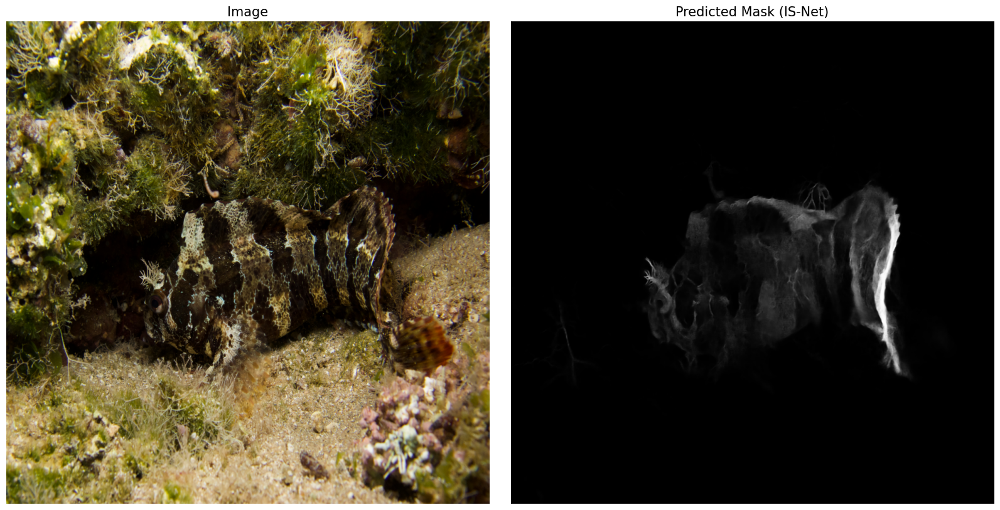

...

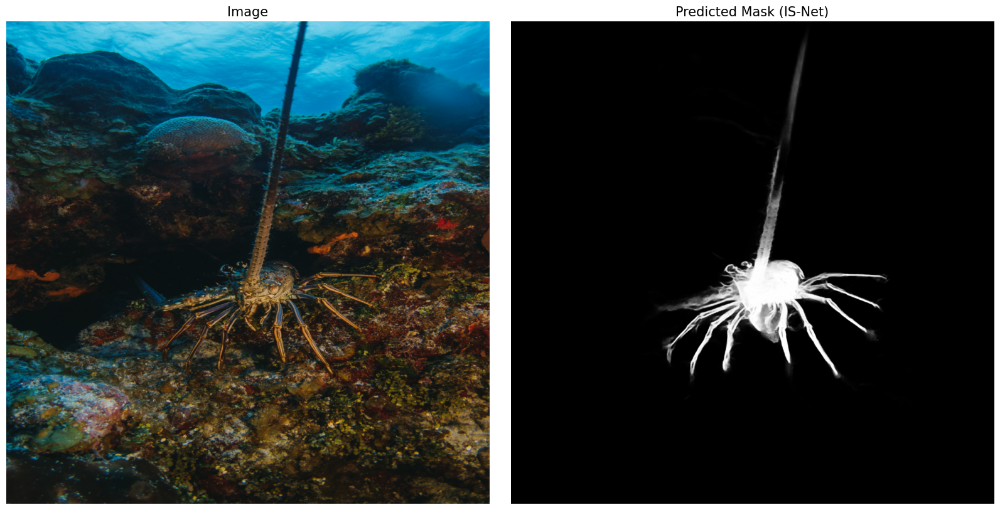

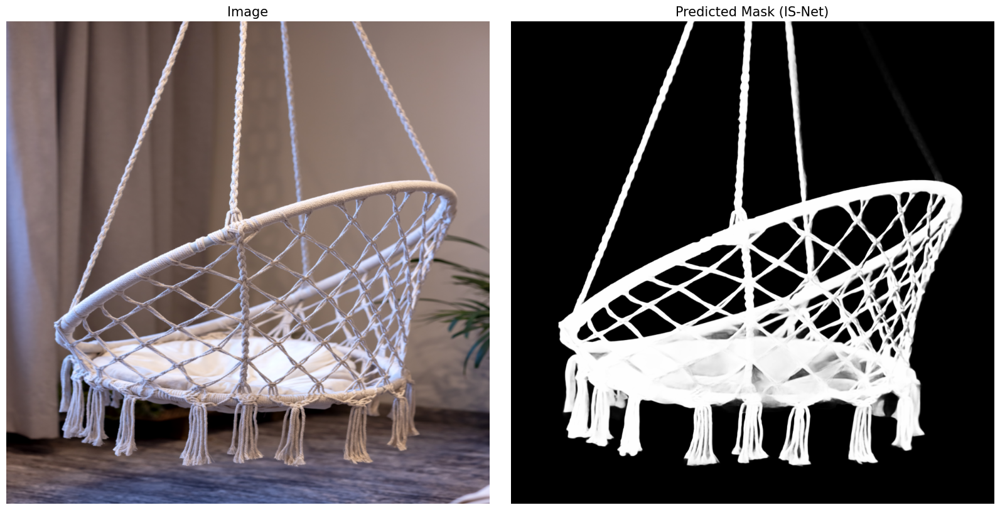

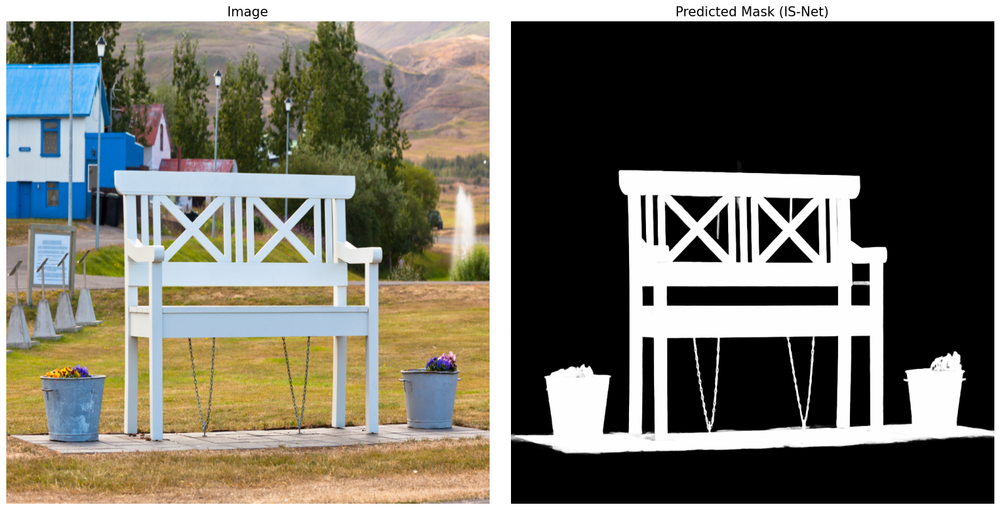

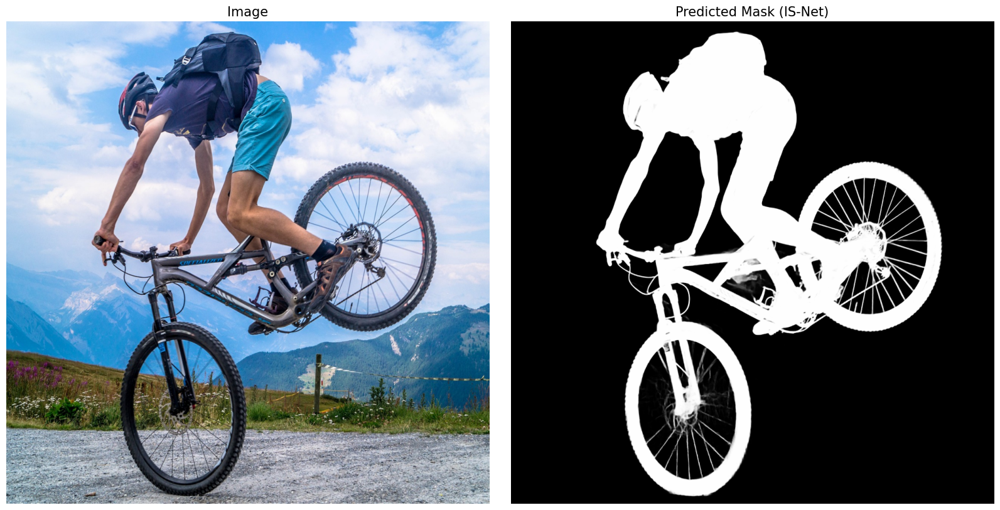

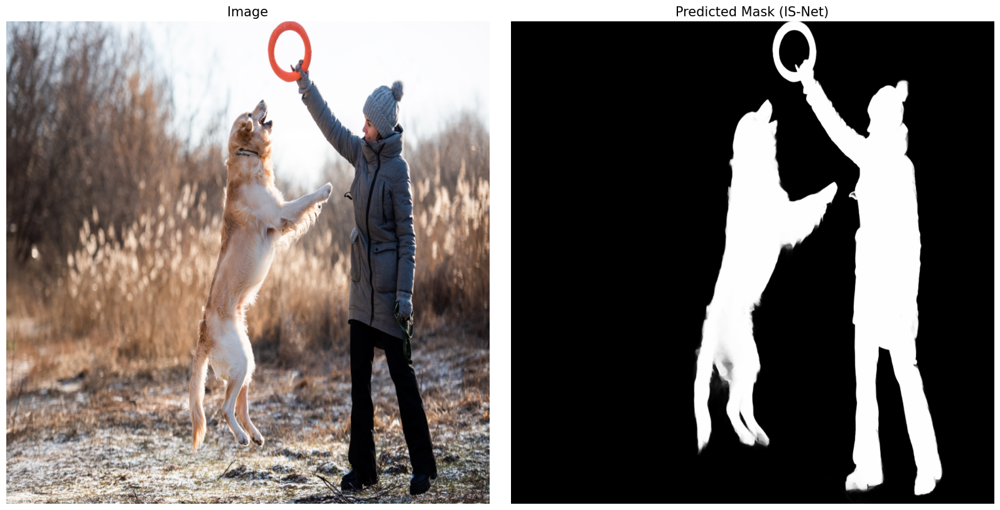

In [ ]:
for idx, (og_image, result) in enumerate(zip(image_batch.cpu(), predictions_isnet),1):

    pred_normalize = normPRED(result)
    pred_final = np.clip(pred_normalize*255., a_min=0, a_max=255.).astype("uint8")

    image = denorm_image(og_image, mean=MEAN, std=STD)

    plt.figure(figsize=(16,8), layout="constrained")

    plt.subplot(1,2,1)
    plt.imshow(image)
    plt.title("Image", fontsize=15)
    plt.axis("off")

    plt.subplot(1,2,2)
    plt.imshow(pred_final, cmap="gray")
    plt.title("Predicted Mask (IS-Net)", fontsize=15)
    plt.axis("off")

    plt.show()
    plt.close()

## References

https://github.com/xuebinqin/DIS